# Foraging toolkit demo on simulated agents of three types (Random, Hungry, and Follower)
This notebook uses the foraging toolkit to simulate three types of agents, and infers their preferences from their movement trajectories. 

Users of the foraging toolkit are interested in analyzing animal movement data, with the goal of determining what factors contribute to each agent's decisions of where to move. 

In this demo on simulated data, we consider two possible factors that may influence agents' decisions -- proximity to other agents, and closeness to food. Each factor has an associated score that is computed at each location where an agent might move. These scores are used as derived predictors in a statistical model of agents' movements. 

The fit coefficients of these derived predictor scores can be interpreted as how strongly each factor influences agents' movement decisions. 


In [1]:
# importing packages. See https://github.com/BasisResearch/collab-creatures for repo setup
import logging
import os
import random
import time

import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import pyro
import pyro.distributions as dist
import pyro.optim as optim
import torch
from pyro.infer import SVI, Predictive, Trace_ELBO
from pyro.infer.autoguide import AutoMultivariateNormal, init_to_mean

from collab.utils import find_repo_root

root = find_repo_root()
from collab.foraging import random_hungry_followers as rhf
from collab.foraging import toolkit as ft

logging.basicConfig(format="%(message)s", level=logging.INFO)

# users can ignore smoke_test -- it's for automatic testing on GitHub, to make sure the notebook runs on future updates to the repository
smoke_test = "CI" in os.environ
num_frames = 5 if smoke_test else 50
num_svi_iters = 10 if smoke_test else 1000
num_samples = 10 if smoke_test else 1000


notebook_starts = time.time()

## Random foragers

We'll first simulated a group of randomly moving agents. 

### Running a simulation
The `random-hungry-followers` module, imported as `rhf`, lets us simulate different groups of agents foraging in a gridworld environment. You can adjust how big the environment is, how many agents are in the group, how much food reward is present, etc. The `probabilities` argument controls the (unnormalized) probability of choosing a step of each size in [-max_step_size, max_step_size]. For further explanation of what each input parameter means, run `help(rhf.RandomForagers.__init__)`

In [2]:
random.seed(23)
np.random.seed(23)

random_foragers_sim = rhf.RandomForagers(
    grid_size=40,
    probabilities=[1, 2, 3, 2, 1, 2, 3, 2, 1],
    num_foragers=3,
    num_frames=num_frames,
    num_rewards=15,
    grab_range=3,
)

# run a particular simulation with these parameters
random_foragers_sim()

# the results of the simulation are stored in `random_foragers_sim.foragersDF`.
# each row contains the x and y coordinates of a forager at a particular time

random_foragers_sim.foragersDF.head()

,x,y,time,forager,type
0,20.0,23.0,1,1,random
1,24.0,23.0,2,1,random
2,26.0,25.0,3,1,random
3,24.0,28.0,4,1,random
4,22.0,26.0,5,1,random


In [3]:
# You can visualize the foragers' movements using the `animate_foragers` function.
ft.animate_foragers(
    random_foragers_sim, plot_rewards=True, width=600, height=600, point_size=6
)

### Derived predictors
Suppose we observed this movement data from agents out in the world, and have several hypotheses for what may be contributing to the agents' movement decisions. We'll calculate derived predictor scores, which have high weight at locations/times where that hypothesis predicts that birds would want to go. 

**Food trace** -- higher at locations closer to food

**Proximity trace** -- highest at agents' hypothesized prefered proximity to other agents (not too close, not too far)

In [4]:
# add derived predictors to the simulation object

preferred_proximity = 4  # the distance at which foragers prefer to be from each other
random_foragers_derived = ft.derive_predictors(
    random_foragers_sim, optimal=preferred_proximity, dropna=False
)

# random_foragers_derived.derivedDF.to_csv('foragers1.csv', index=False)

2024-03-10 15:36:55,133 - traces done
2024-03-10 15:36:55,351 - visibility done
2024-03-10 15:36:55,499 - proximity done
2024-03-10 15:36:55,567 - how_far done
2024-03-10 15:36:55,592 - derivedDF done
2024-03-10 15:36:55,593 - starting to generate communicates
2024-03-10 15:36:55,866 - communicates done


In [5]:
# now we can plot the derived food traces in time:

ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_traces=True,
)

In [6]:
# this exports and crops frame 0
if not smoke_test:
    trace_anim = ft.animate_foragers(
        random_foragers_derived,
        plot_rewards=True,
        width=600,
        height=600,
        point_size=10,
        plot_traces=True,
        produce_object=True,
    )

    trace_frame3 = go.Figure(trace_anim.frames[0].data, trace_anim.layout)
    trace_frame3.update_layout(title_text="food traces")

# this exports figures
# pio.write_image(
#     trace_frame3,
#     os.path.join(root, "docs/figures/fig2_trace.png"),
#     engine="kaleido",
#     width=600,
#     height=600,
#     scale=5,
# )

# trace_frame3_image = Image.open(os.path.join(root, "docs/figures/fig2_trace.png"))
# trace_frame3_cropped = trace_frame3_image.crop((600, 250, 3050, 2000))
# trace_frame3_cropped.save(os.path.join(root, "docs/figures/fig2_trace_cropped.png"))

In [7]:
# Each forager has a limited visibility range.
# We can plot this for one forager at a time
# as multiple foragers' visibility is hard to see
# let's say, forager 2

ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_visibility=2,
    plot_traces=True,
)

In [8]:
# Plot the derived proximity score
# forager 2 again

ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_proximity=2,
    proximity_multiplier=25,
)

In [9]:
# this exports and crops frame 3
prox_anim = ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_proximity=2,
    proximity_multiplier=25,
    produce_object=True,
)

prox_frame3 = go.Figure(prox_anim.frames[0].data, prox_anim.layout)
prox_frame3.update_layout(title_text="Proximity scores (forager 2)")

# this exports figures
# pio.write_image(
#     prox_frame3,
#     os.path.join(root, "docs/figures/fig2_proximity.png"),
#     engine="kaleido",
#     width=600,
#     height=600,
#     scale=5,
# )

# prox_frame3_image = Image.open(os.path.join(root, "docs/figures/fig2_proximity.png"))
# prox_frame3_cropped = prox_frame3_image.crop((600, 250, 3050, 2000))
# prox_frame3_cropped.save(os.path.join(root, "docs/figures/fig2_proximity_cropped.png"))

### Inference
Next, we use the derived predictors to infer how strongly each factor contributes to agents' movement decisions. 

The outcome variable that we're trying to predict corresponds to where the agent moves at each moment. This is encapsulated in the `how_far_score` variable, which is highest at the location where the agent actually moved, and drops off exponentially from there. It is only computed at locations close enough to the agents current location that the agent is able to jump there. 

In [10]:
def prep_data_for_inference(sim_derived):
    df = sim_derived.derivedDF[
        [
            "proximity_standardized",
            "trace_standardized",
            "visibility",
            "how_far_squared_scaled",
        ]
    ]

    df.dropna(inplace=True)

    for column in df.columns:
        df[column] = ft.normalize(df[column])

    data = torch.tensor(df.values, dtype=torch.float32)

    proximity, trace, visibility, how_far_score = (
        data[:, 0],
        data[:, 1],
        data[:, 2],
        data[:, 3],
    )

    print(
        str(len(proximity))
        + " data points prepared for inference, dropped "
        + str(len(sim_derived.derivedDF) - len(proximity))
        + " rows with missing values."
    )
    return proximity, trace, visibility, how_far_score

In [11]:
proximity, trace, visibility, how_far_score = prep_data_for_inference(
    random_foragers_derived
)

42707 data points prepared for inference, dropped 873 rows with missing values.


In [12]:
# plot how_far_score as a function of food trace and proximity score
ft.visualise_forager_predictors(trace, proximity, how_far_score)

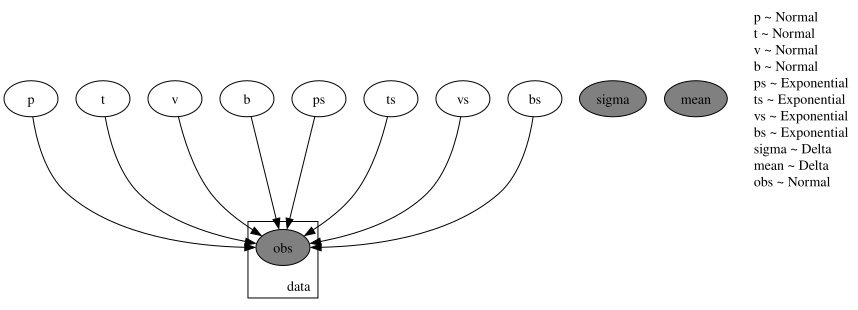

In [13]:
# define the probabilistic model using pyro (https://pyro.ai/)
# p, t, v, b are the coefficients
# for proximity, trace, visibility, and the intercept

# ps, ts, vs, bs are analogous coefficients,
# but they contribute to the variance,
# which is not assumed to remain fixed


def model_sigmavar(proximity, trace, visibility, how_far_score):
    p = pyro.sample("p", dist.Normal(0, 0.2))
    t = pyro.sample("t", dist.Normal(0, 0.2))
    v = pyro.sample("v", dist.Normal(0, 0.2))
    b = pyro.sample("b", dist.Normal(0.5, 0.3))

    ps = pyro.sample("ps", dist.Exponential(7))
    ts = pyro.sample("ts", dist.Exponential(7))
    vs = pyro.sample("vs", dist.Exponential(7))
    bs = pyro.sample("bs", dist.Exponential(7))

    sigma = pyro.deterministic(
        "sigma", bs + ps * proximity + ts * trace + vs * visibility
    )
    mean = pyro.deterministic("mean", b + p * proximity + t * trace + v * visibility)

    with pyro.plate("data", len(how_far_score)):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=how_far_score)


pyro.render_model(
    model_sigmavar,
    model_args=(proximity, trace, visibility, how_far_score),
    render_distributions=True,
)

In [14]:
# helper functions for inference, showing results


def summary(samples, sites):
    site_stats = {}
    for site_name, values in samples.items():
        if site_name in sites:
            marginal_site = pd.DataFrame(values)
            describe = marginal_site.describe(
                percentiles=[0.05, 0.25, 0.5, 0.75, 0.95]
            ).transpose()
            site_stats[site_name] = describe[
                ["mean", "std", "5%", "25%", "50%", "75%", "95%"]
            ]
    return site_stats


def get_samples(
    proximity,
    trace,
    visibility,
    how_far_score,
    model=model_sigmavar,
    num_svi_iters=num_svi_iters,
    num_samples=num_samples,
):
    guide = AutoMultivariateNormal(model, init_loc_fn=init_to_mean)
    svi = SVI(model_sigmavar, guide, optim.Adam({"lr": 0.01}), loss=Trace_ELBO())

    iterations = []
    losses = []

    logging.info(f"Starting SVI inference with {num_svi_iters} iterations.")
    start_time = time.time()
    pyro.clear_param_store()
    for i in range(num_svi_iters):
        elbo = svi.step(proximity, trace, visibility, how_far_score)
        iterations.append(i)
        losses.append(elbo)
        if i % 200 == 0:
            logging.info("Elbo loss: {}".format(elbo))
    end_time = time.time()
    elapsed_time = end_time - start_time
    logging.info("SVI inference completed in %.2f seconds.", elapsed_time)

    if not smoke_test:
        fig = px.line(
            x=iterations, y=losses, title="ELBO loss", template="presentation"
        )
        labels = {"iterations": "iteration", "losses": "loss"}
        fig.update_xaxes(showgrid=False, title_text=labels["iterations"])
        fig.update_yaxes(showgrid=False, title_text=labels["losses"])
        fig.update_layout(width=700)
        fig.show()

    predictive = Predictive(
        model, guide=guide, num_samples=num_samples, return_sites=["t", "p", "v"]
    )
    rhf_svi = {
        k: v.flatten().reshape(num_samples, -1).detach().cpu().numpy()
        for k, v in predictive(proximity, trace, visibility, how_far_score).items()
        if k != "obs"
    }

    print("SVI-based coefficient marginals:")
    for site, values in summary(rhf_svi, ["t", "p", "v"]).items():
        print("Site: {}".format(site))
        print(values, "\n")

    return {"svi_samples": rhf_svi, "svi_guide": guide, "svi_predictive": predictive}


def calculate_R_squared(guide):
    predictive = pyro.infer.Predictive(model_sigmavar, guide=guide, num_samples=1000)
    predictions = predictive(proximity, trace, visibility, how_far_score)

    simulated_outcome = (
        predictions["b"]
        + predictions["p"] * proximity
        + predictions["t"] * trace
        + predictions["v"] * visibility
    )

    mean_sim_outcome = simulated_outcome.mean(0).detach().cpu().numpy()

    observed_mean = torch.mean(how_far_score)

    tss = torch.sum((how_far_score - observed_mean) ** 2)
    rss = torch.sum((how_far_score - mean_sim_outcome) ** 2)

    r_squared = 1 - (rss / tss)

    return r_squared.float().item()

In [15]:
samples_random = get_samples(proximity, trace, visibility, how_far_score)

2024-03-10 15:36:59,668 - Starting SVI inference with 1000 iterations.
2024-03-10 15:36:59,848 - Elbo loss: 12301.476986348629
2024-03-10 15:37:01,099 - Elbo loss: -20580.336824297905
2024-03-10 15:37:02,353 - Elbo loss: -20282.797012209892
2024-03-10 15:37:03,477 - Elbo loss: -22833.382807374
2024-03-10 15:37:04,707 - Elbo loss: -22291.744973301888
2024-03-10 15:37:05,833 - SVI inference completed in 6.16 seconds.


SVI-based coefficient marginals:
Site: p
       mean       std        5%       25%       50%       75%       95%
0 -0.001847  0.036534 -0.062821 -0.025959 -0.001266  0.022145  0.056511 

Site: t
       mean       std        5%       25%     50%       75%       95%
0 -0.041236  0.049052 -0.121238 -0.073159 -0.0404 -0.007863  0.035983 

Site: v
       mean       std        5%       25%       50%       75%       95%
0  0.400592  0.023737  0.360837  0.384737  0.400051  0.417177  0.439155 



In [16]:
# plot the inferred posterior distributions of the coefficients
ft.plot_coefs(
    samples_random, "Random foragers", nbins=120, ann_start_y=160, ann_break_y=50
)

In [17]:
print("R squared:", calculate_R_squared(samples_random["svi_guide"]))

R squared: 0.42003190517425537


## Hungry birds

Moving on from random agents, we'll simulate agents that move toward food. We'll use more frames,and a larger gridworld environment. The simulation might take a bit longer.

In [18]:
random.seed(23)
np.random.seed(23)

hungry_sim = rhf.Foragers(
    grid_size=60, num_foragers=3, num_frames=num_frames, num_rewards=60, grab_range=3
)

hungry_sim()

hungry_sim = rhf.add_hungry_foragers(
    hungry_sim, num_hungry_foragers=3, rewards_decay=0.3, visibility_range=6
)

2024-03-10 15:37:20,410 - Generating frame 10/50 
2024-03-10 15:37:30,145 - Generating frame 20/50 
2024-03-10 15:37:38,173 - Generating frame 30/50 
2024-03-10 15:37:44,145 - Generating frame 40/50 


In [19]:
ft.animate_foragers(
    hungry_sim,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_traces=False,
)

In [20]:
# adding derived predictors
hungry_sim_derived = ft.derive_predictors(hungry_sim, dropna=False)

# if export is needed
# hungry_sim_derived.derivedDF.to_csv("foragers2.csv", index=False)

# plot with trace
# bird 2 again
ft.animate_foragers(
    hungry_sim_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_traces=True,
    trace_multiplier=7,
)

2024-03-10 15:37:49,396 - traces done
2024-03-10 15:37:49,550 - visibility done
2024-03-10 15:37:49,701 - proximity done
2024-03-10 15:37:49,770 - how_far done
2024-03-10 15:37:49,799 - derivedDF done
2024-03-10 15:37:49,799 - starting to generate communicates
2024-03-10 15:37:50,097 - communicates done


In [21]:
# now plot proximity
ft.animate_foragers(
    hungry_sim_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_proximity=1,
)

In [22]:
proximity, trace, visibility, how_far_score = prep_data_for_inference(
    hungry_sim_derived
)

41139 data points prepared for inference, dropped 841 rows with missing values.


In [23]:
# plot how_far_score as a function of proximity and food trace scores
# notice how all the points with high food trace scores
# have how_far_score close to 1,
# while how_far_score does not seem to systematically
# vary with proximity score

ft.visualise_forager_predictors(trace, proximity, how_far_score)

In [24]:
# run inference (SVI), and collect samples from the posterior
samples_hungry = get_samples(proximity, trace, visibility, how_far_score)

2024-03-10 15:37:51,700 - Starting SVI inference with 1000 iterations.
2024-03-10 15:37:51,749 - Elbo loss: 34590.011952996254
2024-03-10 15:37:53,462 - Elbo loss: -9291.405119895935
2024-03-10 15:37:55,126 - Elbo loss: -11398.557615756989
2024-03-10 15:37:56,794 - Elbo loss: -12507.240985751152
2024-03-10 15:37:58,492 - Elbo loss: -12262.315590977669
2024-03-10 15:38:00,173 - SVI inference completed in 8.47 seconds.


SVI-based coefficient marginals:
Site: p
      mean       std       5%       25%      50%       75%       95%
0 -0.00438  0.037261 -0.06592 -0.028542 -0.00318  0.020314  0.055659 

Site: t
       mean       std        5%       25%       50%       75%       95%
0  2.222861  0.089974  2.074948  2.162413  2.222857  2.281381  2.366719 

Site: v
       mean       std        5%       25%      50%       75%       95%
0  0.403459  0.024348  0.362867  0.387341  0.40329  0.420066  0.444173 



In [25]:
# plot the sampled posterior distributions of the coefficients
# Note that t, the coefficient for the food trace score, is high for hungry agents
ft.plot_coefs(
    samples_hungry, "Hungry foragers", nbins=160, ann_start_y=160, ann_break_y=10
)

In [26]:
print("R squared:", calculate_R_squared(samples_hungry["svi_guide"]))

R squared: 0.33556318283081055


## Follower birds
Next, we'll simulate agents that don't care about food locations, but instead move to approach other agents, and we'll test that the model is able to correctly infer that these agents care about proximity to other agents, but not food.

In [27]:
random.seed(23)
np.random.seed(23)


follower_sim = rhf.Foragers(
    grid_size=60, num_foragers=3, num_frames=num_frames, num_rewards=30, grab_range=3
)
follower_sim()

follower_sim = rhf.add_follower_foragers(
    follower_sim,
    num_follower_foragers=3,
    visibility_range=6,
    getting_worse=0.5,
    optimal=3,
)

follower_sim_derived = ft.derive_predictors(
    follower_sim, getting_worse=0.5, optimal=3, visibility_range=6, dropna=False
)

# if export is needed
# follower_sim_derived.derivedDF.to_csv("foragers3.csv", index=False)

2024-03-10 15:38:04,939 - Generating frame 10/50 
2024-03-10 15:38:05,123 - Generating frame 20/50 
2024-03-10 15:38:05,311 - Generating frame 30/50 
2024-03-10 15:38:05,519 - Generating frame 40/50 
2024-03-10 15:38:06,303 - traces done
2024-03-10 15:38:06,542 - visibility done
2024-03-10 15:38:06,733 - proximity done
2024-03-10 15:38:06,810 - how_far done
2024-03-10 15:38:06,845 - derivedDF done
2024-03-10 15:38:06,846 - starting to generate communicates
2024-03-10 15:38:07,120 - communicates done


In [28]:
ft.animate_foragers(
    follower_sim_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_proximity=2,
)

In [29]:
proximity, trace, visibility, how_far_score = prep_data_for_inference(
    follower_sim_derived
)

16611 data points prepared for inference, dropped 339 rows with missing values.


In [30]:
# plot how_far_score as a function of the derived predictor scores (food trace and proximity score)
# Observe that the how_far_score is high when the proximity score is high, but doesn't appear to vary systematically with the food trace score
ft.visualise_forager_predictors(trace, proximity, how_far_score)

In [31]:
# run inference (SVI), and collect samples from the posterior
samples_followers = get_samples(proximity, trace, visibility, how_far_score)

2024-03-10 15:38:07,779 - Starting SVI inference with 1000 iterations.
2024-03-10 15:38:07,806 - Elbo loss: 6730.082842588425
2024-03-10 15:38:08,623 - Elbo loss: -5660.238675117493
2024-03-10 15:38:09,414 - Elbo loss: -6307.563529849052
2024-03-10 15:38:10,200 - Elbo loss: -6577.327524602413
2024-03-10 15:38:10,990 - Elbo loss: -6798.644914507866
2024-03-10 15:38:11,776 - SVI inference completed in 3.99 seconds.


SVI-based coefficient marginals:
Site: p
       mean       std        5%       25%       50%       75%       95%
0  0.359746  0.033618  0.303905  0.337945  0.360158  0.381029  0.414092 

Site: t
       mean       std        5%       25%       50%       75%       95%
0 -0.267701  0.046568 -0.346186 -0.298814 -0.267894 -0.235226 -0.190792 

Site: v
      mean      std        5%       25%       50%       75%       95%
0  0.16007  0.02553  0.117781  0.142387  0.160313  0.177049  0.202292 



In [32]:
# plot the sampled posterior distributions of the coefficients
# Note that p, the coefficient for the proximity score, is high for follower agents
ft.plot_coefs(
    samples_followers, "Follower foragers", nbins=140, ann_start_y=160, ann_break_y=10
)

In [33]:
print("R squared:", calculate_R_squared(samples_followers["svi_guide"]))

R squared: 0.24099195003509521


In [34]:
def plot_all_coefficients(
    svi_samples, groups, title, xrange, yrange, generate_object=False
):
    data = {"p": [], "t": [], "inference_method": [], "group": []}

    for i, svi_sample in enumerate(svi_samples):
        site_p_svi = svi_sample["p"].flatten().tolist()
        site_t_svi = svi_sample["t"].flatten().tolist()
        data["p"] += site_p_svi
        data["t"] += site_t_svi
        data["inference_method"] += ["svi"] * len(site_p_svi)
        data["group"] += [groups[i]] * len(site_p_svi)

    df = pd.DataFrame(data)

    fig = px.scatter(
        df, x="p", y="t", color="group", title=title, template="presentation"
    )

    fig.update_xaxes(range=[xrange[0], xrange[1]], showgrid=False)
    fig.update_yaxes(range=[yrange[0], yrange[1]], showgrid=False)

    fig.update_layout(autosize=False, width=600, height=600)

    fig.update_traces(marker=dict(size=12, opacity=0.1))

    if generate_object:
        return fig
    else:
        fig.show()

In [35]:
# plot the inferred coefficients for all three bird types in one scatter plot
# Note that the coefficients for the food trace score (t) are high for hungry agents
# while the coefficients for the proximity score (p) are high for follower agents
# and the random agents have near-zero coefficients for both predictors
svi_samples = [
    samples_random["svi_samples"],
    samples_hungry["svi_samples"],
    samples_followers["svi_samples"],
]

groups = ["random", "hungry", "follower"]

fig2_rhf = plot_all_coefficients(
    svi_samples,
    groups,
    "Coefficients for three bird types",
    [-0.2, 0.5],
    [-1, 2.6],
    generate_object=True,
)

fig2_rhf.update_layout(legend=dict(yanchor="top", y=1.05, xanchor="right", x=0.97))

fig2_rhf.show()

In [36]:
# this exports fig2_rfh

# pio.write_image(
#     fig2_rhf,
#     os.path.join(root, "docs/figures/fig2_rfh.png"),
#     engine="kaleido",
#     width=600,
#     height=600,
#     scale=5,
# )

In [37]:
notebook_ends = time.time()
print(
    "notebook took",
    notebook_ends - notebook_starts,
    "seconds, that is ",
    (notebook_ends - notebook_starts) / 60,
    "minutes to run",
)

notebook took 80.47527885437012 seconds, that is  1.3412546475728353 minutes to run
